# Make figure 6 of the paper
References: 
- https://www.pygmt.org/v0.2.0/gallery/plot/meca.html

In [1]:
import pandas as pd
import pygmt 
from pyproj import Transformer
import matplotlib.pyplot as plt
from obspy.core.event import read_events

import numpy as np
import matplotlib.colors as mcolors
from matplotlib import cm
import pygmt

import tempfile



In [11]:
df = pd.read_csv('../data/datasets_all_regions/origin_2010_2015_reloc_cog_morton_ver3.csv',index_col=0)
df


,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm,id_Morton,dist,dt,NonDimDist
0,47.22533,-122.16895,56.111,1.262305e+09,0,7,2,5,1.081,5.0,235.831208,genie,0,0.753784,4.933721e+07,411143.414481
1,48.19518,-121.77276,3.820,1.262305e+09,1,55,25,30,0.985,30.0,201.698107,genie,0,1.333054,4.933712e+07,411142.646872
2,47.86208,-122.09903,17.799,1.262330e+09,2,28,10,18,0.784,18.0,181.023074,genie,0,0.957326,4.931184e+07,410932.027590
3,47.96435,-122.91906,21.286,1.262336e+09,3,20,10,10,0.465,10.0,150.528010,genie,0,0.684951,4.930621e+07,410885.088574
4,45.87262,-122.19180,9.822,1.262362e+09,4,39,20,19,0.657,19.0,237.324295,genie,0,1.627692,4.927976e+07,410664.693011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63882,40.59439,-124.42438,19.741,1.435097e+09,63882,23,9,14,1.015,14.0,73.959960,genie,4408,0.112501,7.919735e+03,65.997794
63883,40.54636,-127.10076,26.165,1.435100e+09,63883,12,1,11,0.744,11.0,223.080984,genie,4408,2.139193,9.995899e+03,83.299204
63884,49.74167,-124.58578,5.274,1.435101e+09,63884,13,7,6,0.894,6.0,197.904075,genie,4408,9.188393,1.107364e+04,92.281049
63885,40.64363,-125.36531,1.891,1.435101e+09,63885,8,3,5,0.982,5.0,145.748415,genie,4408,0.824720,1.158579e+04,96.548245


In [12]:
_df = df[(df.rms < 2.5) & (df.p_picks > 4) & (df.s_picks > 4)].sort_values('nass', ascending=True)
_df

,lat,lon,depth,time,orid,nass,p_picks,s_picks,rms,nsphz,gap,algorithm,id_Morton,dist,dt,NonDimDist
92,40.39017,-124.26529,21.344,1.262785e+09,92,10,5,5,0.139,5.0,248.688402,genie,1,3.898960,4.885739e+07,407144.938225
188,40.58319,-124.74977,20.747,1.263089e+09,188,10,5,5,0.229,5.0,325.567758,genie,1,3.718278,4.855300e+07,404608.294751
190,40.56413,-124.71725,17.893,1.263089e+09,190,10,5,5,0.289,5.0,324.367216,genie,1,3.735384,4.855287e+07,404607.257479
191,40.65043,-124.63284,18.936,1.263089e+09,191,10,5,5,0.173,5.0,321.243107,genie,1,3.645034,4.855268e+07,404605.625998
194,40.51176,-124.64650,15.746,1.263090e+09,194,10,5,5,0.417,5.0,321.393995,genie,1,3.784074,4.855221e+07,404601.789071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46632,48.17382,-122.70349,52.237,1.401017e+09,46632,146,72,74,1.274,74.0,104.764319,genie,1880,3.007186,1.121952e+05,934.959815
22644,43.42639,-127.20676,9.676,1.340113e+09,22644,147,110,37,1.420,37.0,208.863738,genie,306,5.891495,6.026427e+03,50.220782
18656,48.74665,-128.13167,44.739,1.328386e+09,18656,152,102,50,1.296,50.0,193.110739,genie,155,5.226390,6.954134e+03,57.951495
20177,48.32102,-122.30360,10.816,1.332624e+09,20177,166,96,70,1.738,70.0,148.662855,genie,207,4.215390,1.466634e+04,122.219600


In [13]:
method = 'reloc'
year = 'all_regions'
version = 'ver3'
# Load the catalogs 
matched_events_mycatalog2morton= pd.read_csv(f'../data/datasets_{year}/matched_events_with_morton_mycatalog_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
unmatched_events_mycatalog2morton_and_anss= pd.read_csv(f'../data/datasets_{year}/new_events_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
# new_events_filtered = pd.read_csv(f'../data/datasets_{year}/new_events_filtered_{year}.csv')
unmatched_events_morton2mycatalog= pd.read_csv(f'../data/datasets_{year}/missing_events_from_mycatalog_morton_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
matched_events_morton2mycatalog= pd.read_csv(f'../data/datasets_{year}/matched_events_with_mycatalog_morton_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
unmatched_events_anss2mycatalog = pd.read_csv(f'../data/datasets_{year}/missing_events_from_mycatalog_anss_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
matched_events_mycatalog2anss= pd.read_csv(f'../data/datasets_{year}/matched_events_with_anss_mycatalog_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')
matched_events_anss2mycatalog= pd.read_csv(f'../data/datasets_{year}/matched_events_with_mycatalog_anss_{method}_cog_morton_{version}_p_4_s_4_rms_2_5.csv')

unmatched_events_mycatalog2morton_and_anss = _df.loc[_df.orid.isin(unmatched_events_mycatalog2morton_and_anss.orid)].copy()


anss_events = pd.read_csv('../data/datasets_anss/anss_2010-15.csv')

In [60]:
len(unmatched_events_mycatalog2morton_and_anss)+len(matched_events_mycatalog2morton)+len(matched_events_mycatalog2anss)


32021

In [61]:
len(unmatched_events_mycatalog2morton_and_anss)+len(matched_events_morton2mycatalog)+len(matched_events_anss2mycatalog)


32021

## Entire Region

/tmp/ipykernel_1327816/4064612463.py:31: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
/tmp/ipykernel_1327816/4064612463.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


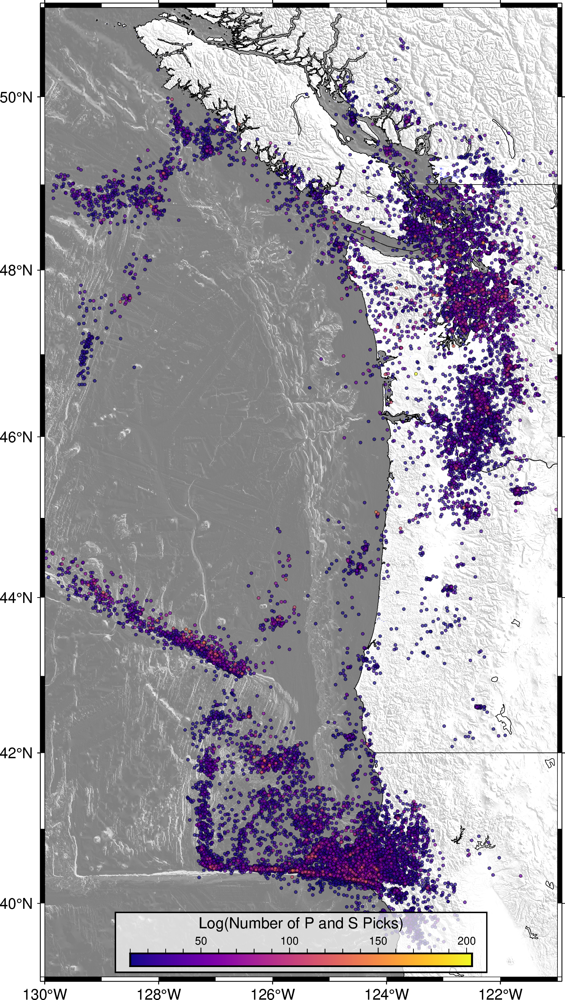

In [47]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])

# Plot a dummy point to add the station legend
fig.plot(x=[-110], y=[48], style="c0.07c", color="white", label="Catalog Event", pen="0.2p,black")
# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(
    x=_df["lon"],
    y=_df["lat"],
    style="c0.07c",
    color=_df["nass"] ,  # Apply log transformation for color mapping
    cmap=True,
    pen="0.1p,black",
    transparency=30
)

# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lLog(Number of P and S Picks)"],
)
# Save the figure
fig.savefig("../data/datasets_all_regions/all_catalog_events_2010_2015_ver3_nass_log.pdf")

# Display the figure
fig.show()


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/4105516475.py:32: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/4105516475.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

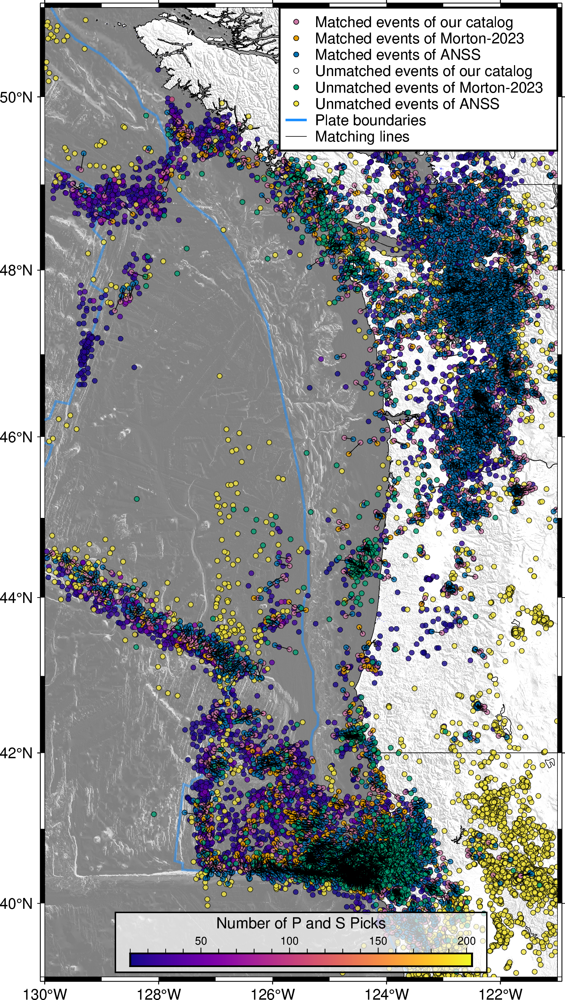

In [56]:


fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(a)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")
# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )

# focal_mechanism = dict(
#     strike=df.strike,
#     dip=df.dip,
#     rake=df.rake,
#     magnitude=df.mag  # Depth in km
# )

# offset_beachball = 0.3
# # pass the focal mechanism data to meca in addition to the scale and event location
# fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)
# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lNumber of P and S Picks"],
)

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig(f"../data/datasets_{year}/matched_events_{year}_reloc_cog_morton_ver3_p_4_s_4_rms_2_5_nass_no_label_match_nass.png")

# Display the figure
fig.show()


## Plot with the focal mechanisms

In [22]:
usgs_cat = read_events('Cascadia_momenttensors.xml')

In [23]:
# %matplotlib widget
lon = []
lat = []
strike = []
dip = []
rake = []
magnitude = []
depth = []
for c in usgs_cat:
    lon.append(c.origins[0].longitude)
    lat.append(c.origins[0].latitude)
    
    nodalplane = c.focal_mechanisms[1].nodal_planes.nodal_plane_1
    sdr = [nodalplane.strike,nodalplane.dip,nodalplane.rake]
    mag = c.preferred_magnitude().mag
    depth = c.origins[0].depth / 1000.0  # Convert depth from meters to kilometers
    magnitude.append(mag)
    strike.append(sdr[0])
    dip.append(sdr[1])
    rake.append(sdr[2])

df = pd.DataFrame({'lon': lon, 'lat': lat, 'strike': strike, 'dip': dip, 'rake': rake, 'mag': mag, 'depth': depth})
# Plot the data

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/98897103.py:32: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/98897103.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plo

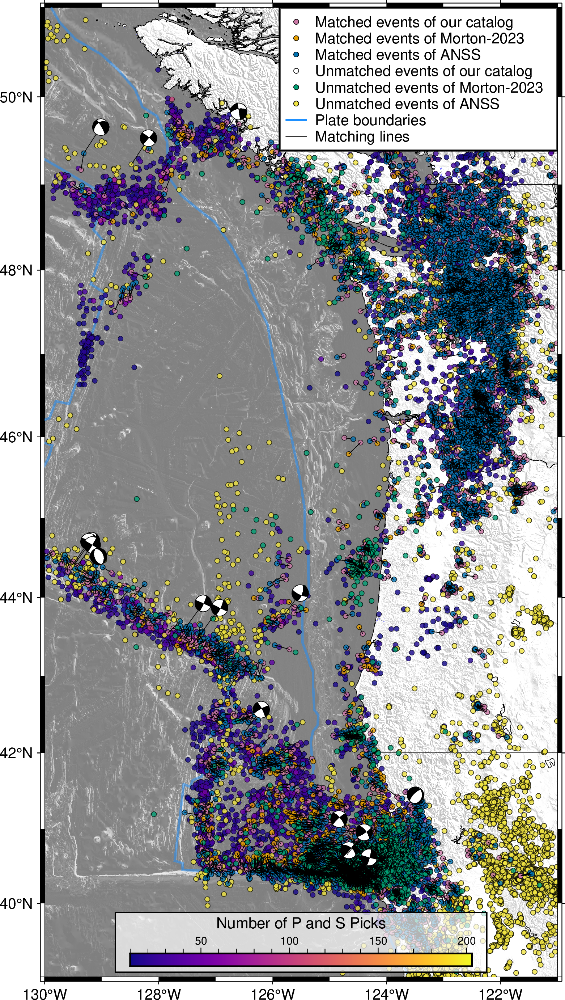

In [55]:


fig = pygmt.Figure()

# Define target region
min_lat = 39
max_lat = 51
min_lon = -130
max_lon = -121

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(a)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")
# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)
# Add title text
fig.colorbar(
    position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
    box="+gwhite@30+p0.8p,black",
    frame=["x+lNumber of P and S Picks"],
)

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig(f"../data/datasets_{year}/matched_events_{year}_reloc_cog_morton_ver3_p_4_s_4_rms_2_5_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()


## Axial and Endeavor


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/4209775262.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/4209775262.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

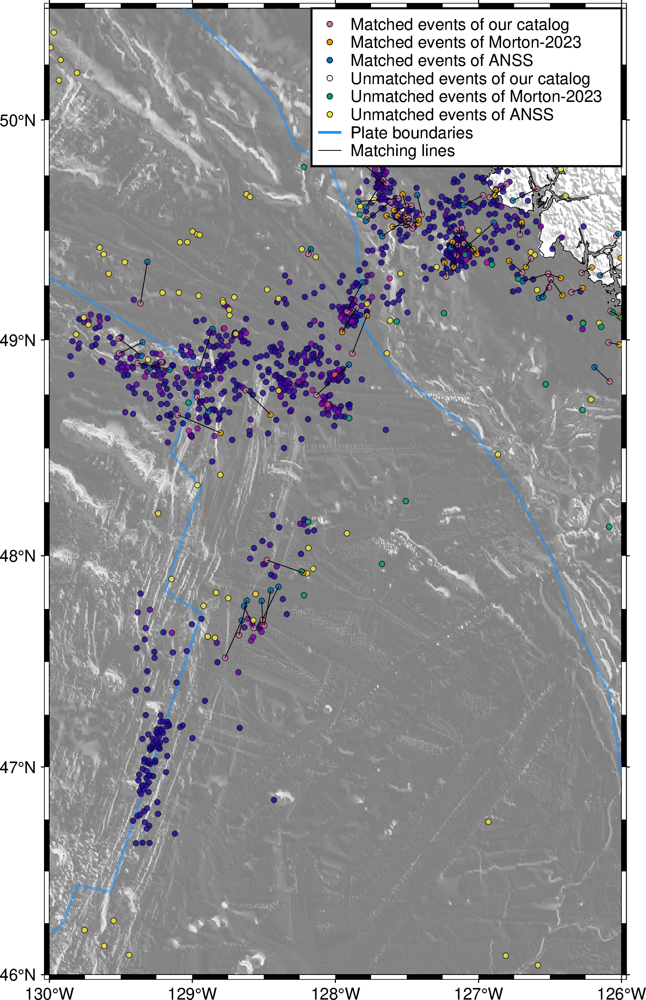

In [58]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )


# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')


# Save the figure
fig.savefig("../data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_nass_no_label_match_nass.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/3453772150.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/3453772150.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

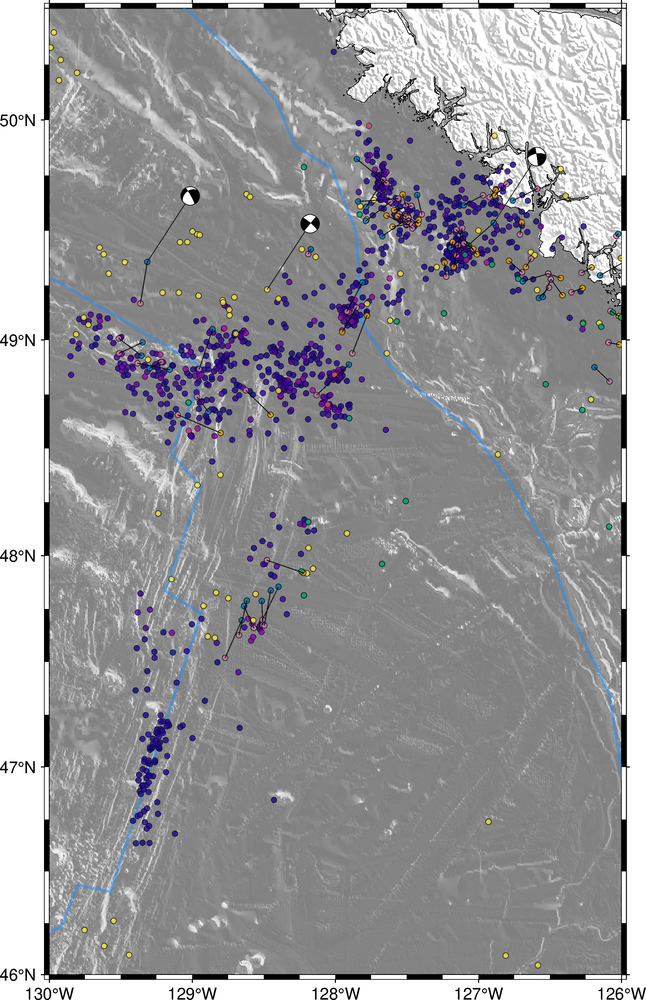

In [57]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50.5
min_lon = -130
max_lon = -126

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
# fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')


# Save the figure
fig.savefig("../data/datasets_all_regions/axial_endeavor_events_2010_2015_ver3_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()


## Mendicino


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/3438008376.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/3438008376.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

/tmp/ipykernel_1338264/3438008376.py:66: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/3438008376.py:71: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/3438008376.py:76: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/3438008376.py:81: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/3438008376.py:86: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/3438008376.py:91: FutureWarning: The 'color' parameter has been dep

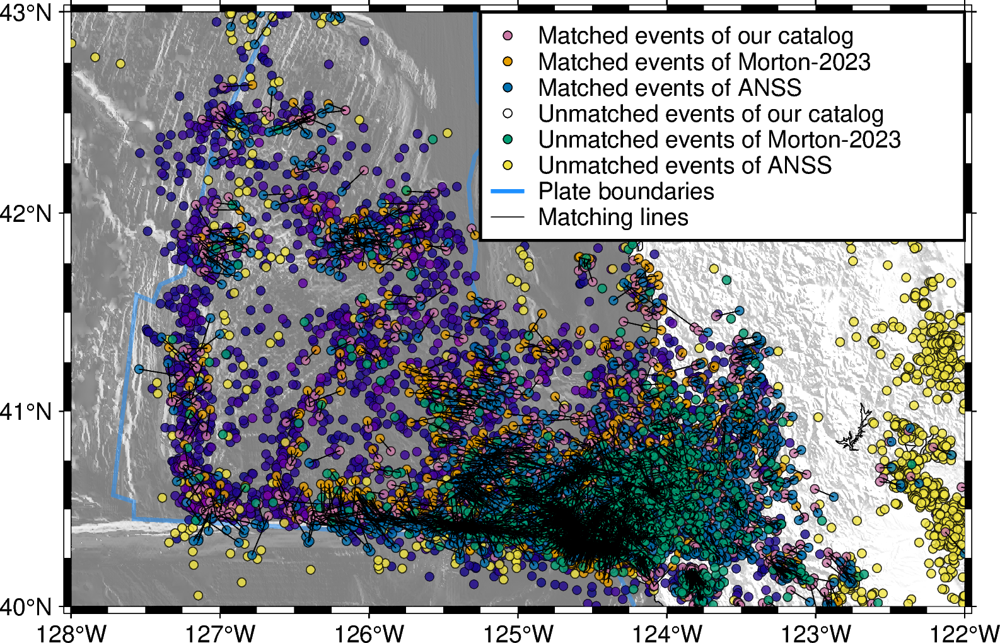

In [45]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )



# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_2010_2015_ver3_nass_no_label_match_nass.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/993256581.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/993256581.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.p

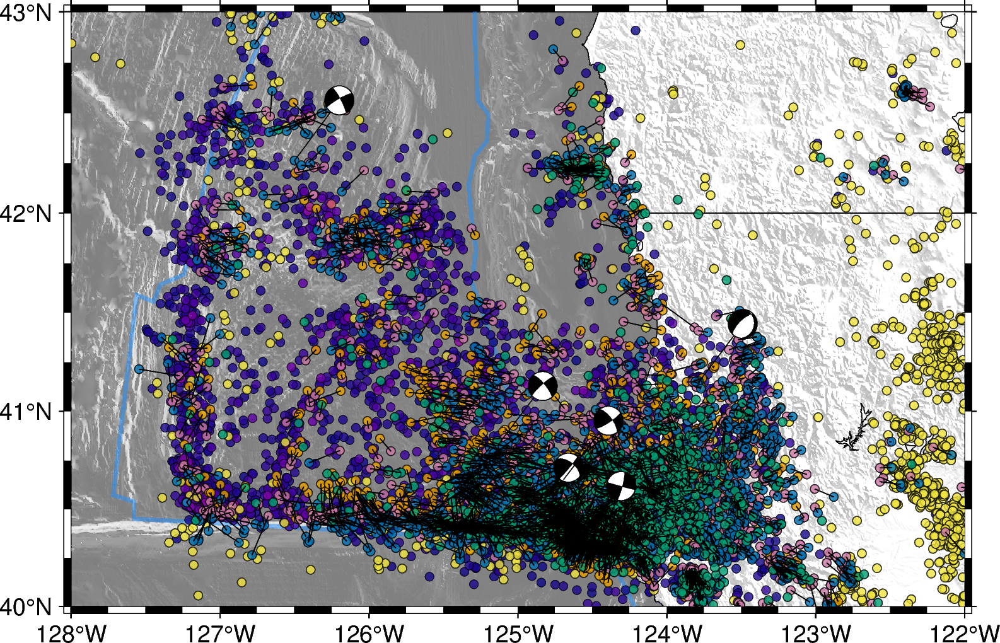

In [46]:

# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 43
min_lon = -128
max_lon = -122

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )


focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
# fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_2010_2015_ver3_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()

## A zoomed-in view of the junction

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/899872454.py:37: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/899872454.py:39: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.p

/tmp/ipykernel_1338264/899872454.py:73: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=_df["lon"],y=_df["lat"],style="c0.12c",color=_df["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/899872454.py:74: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],
/tmp/ipykernel_1338264/899872454.py:76: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],
/tmp/ipykernel_1338264/899872454.py:78: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' inst

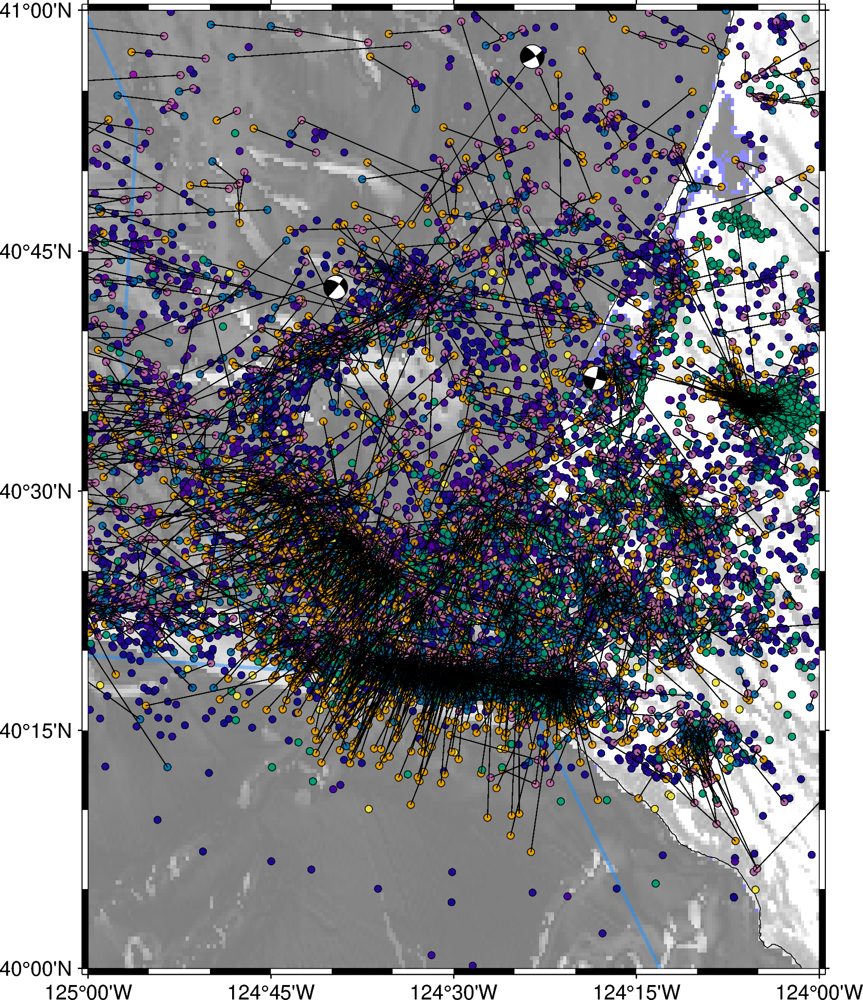

In [54]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 40
max_lat = 41
min_lon = -125
max_lon = -124


# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Apply logarithmic scale for color mapping
# Apply log10 transformation to nass values and set color palette
nass_log_min = _df['nass'].min()  # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max()
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])
title = ""

# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)

fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=_df["lon"],y=_df["lat"],style="c0.12c",color=_df["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )


focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)


# Add a legend for the pick scale to the plot
# fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/mendocino_events_zoomed_in_2010_2015_ver3_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()


## Around 44.5N


plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/1917447464.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/1917447464.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

/tmp/ipykernel_1338264/1917447464.py:66: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/1917447464.py:71: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/1917447464.py:76: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/1917447464.py:81: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/1917447464.py:86: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1338264/1917447464.py:91: FutureWarning: The 'color' parameter has been dep

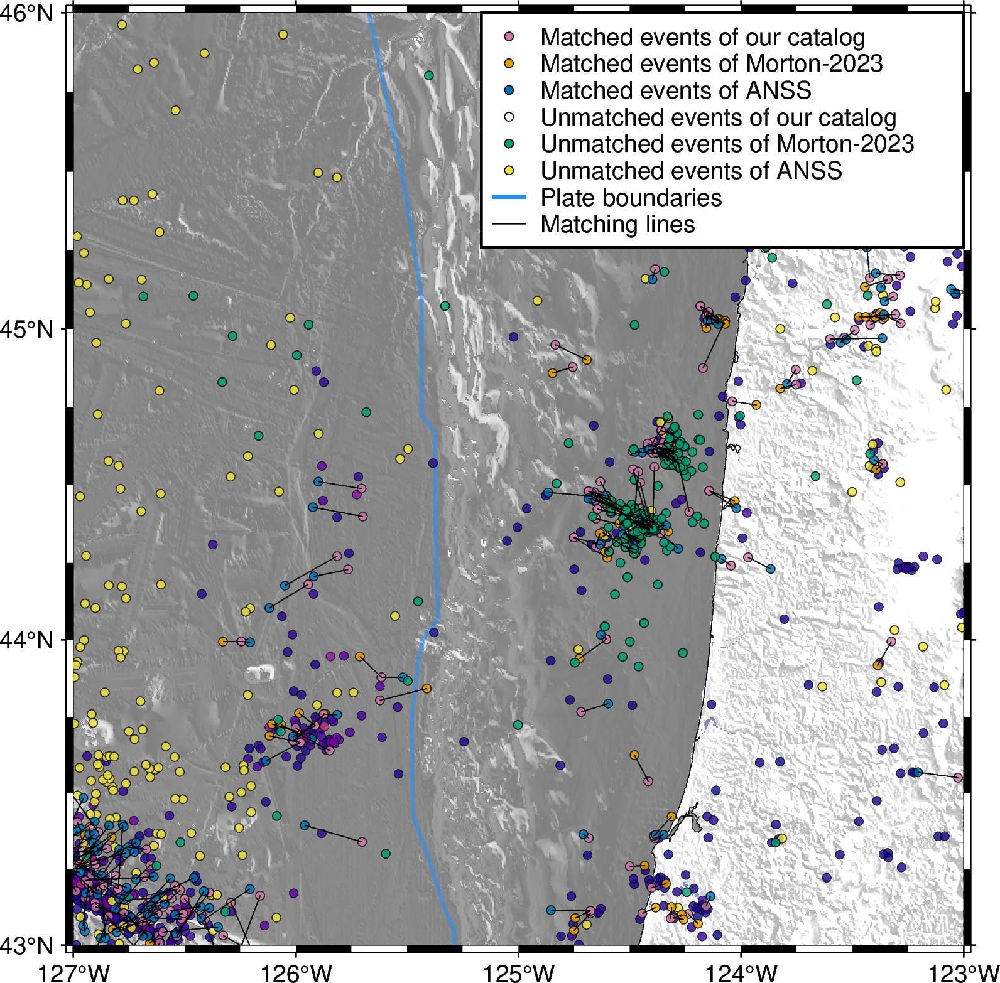

In [48]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )



# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/around_445_events_2010_2015_ver3_nass_no_label_match_nass.png")

# Display the figure
fig.show()


## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/3867509120.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/3867509120.py:36: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

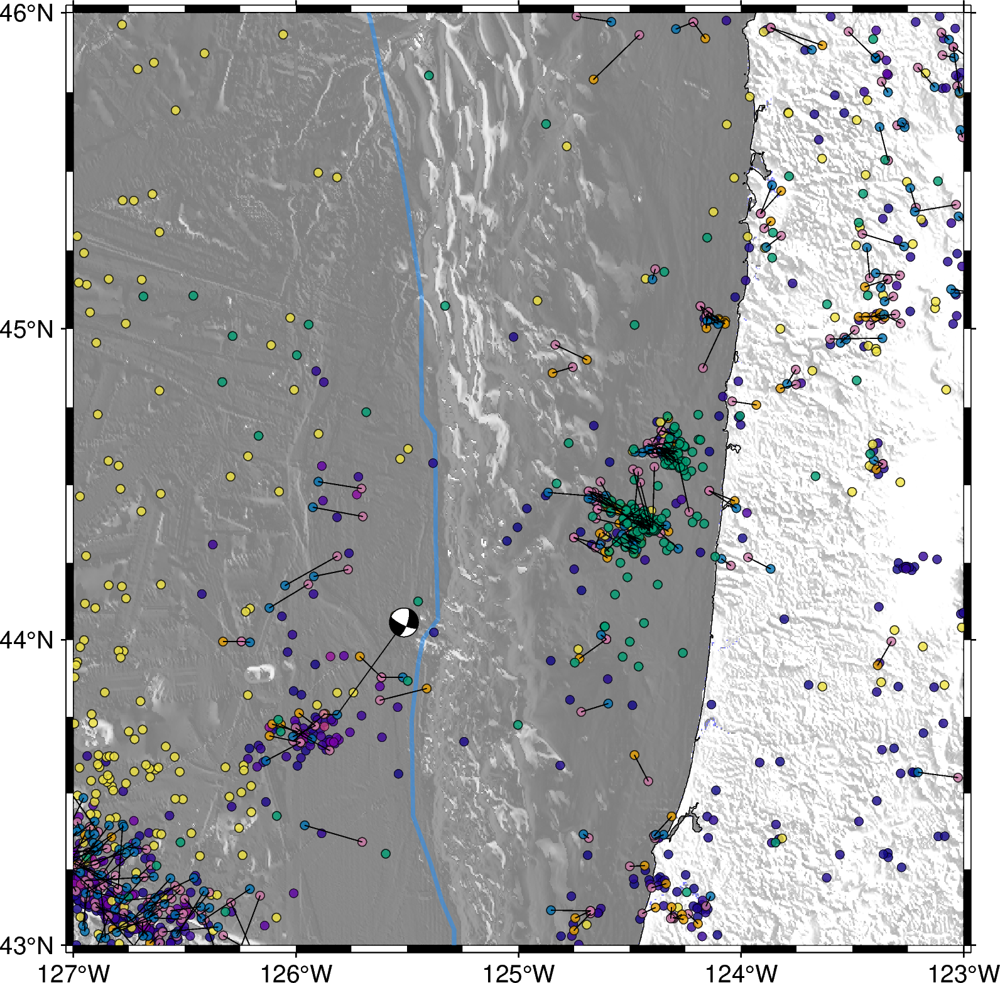

In [49]:


# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 43
max_lat = 46
min_lon = -127
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(b)"


# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
# fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')
# Save the figure
fig.savefig("../data/datasets_all_regions/around_445_events_2010_2015_ver3_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()


## Northern WA

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/348617765.py:34: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/348617765.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.p

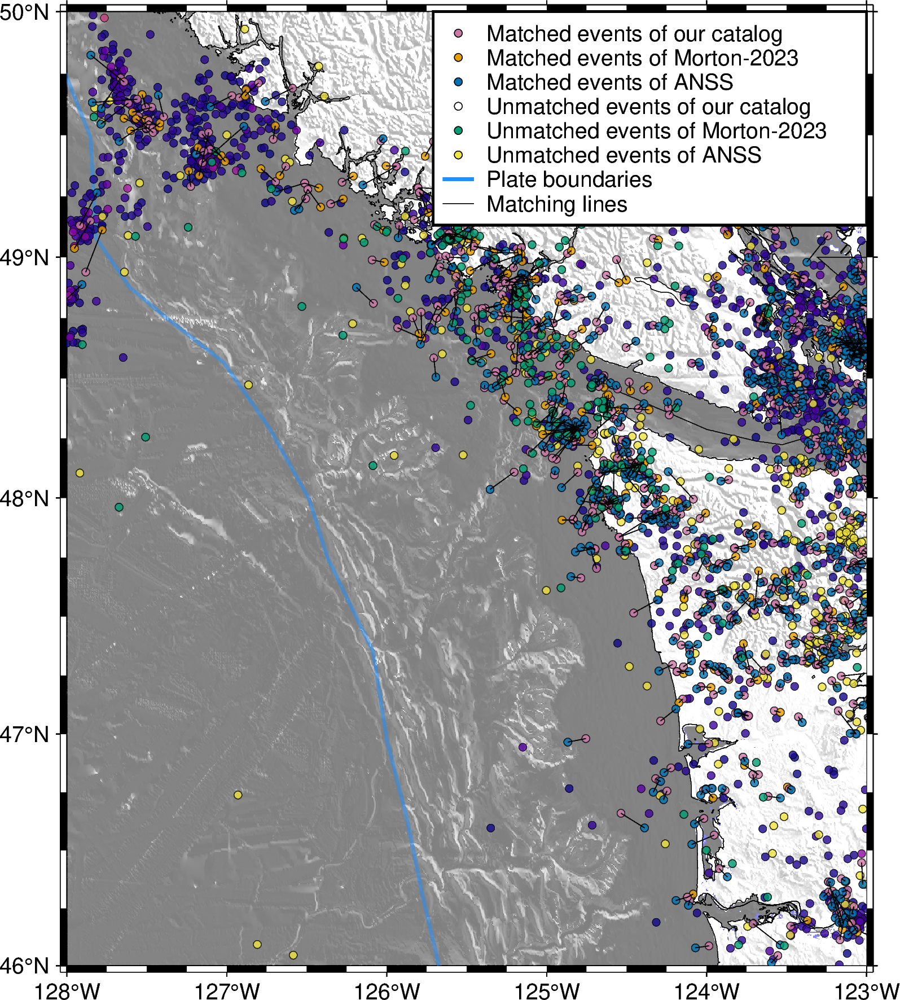

In [50]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )



# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig("../data/datasets_all_regions/northern_wa_events_2010_2015_ver3_nass_no_label_match_nass.png")

# Display the figure
fig.show()

## With focal mechanism

plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 1684 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5086 in file PB2002_boundaries.dig
plot [WARNING]: Mismatch between actual (1) and expected (2) fields near line 5113 in file PB2002_boundaries.dig
plot [WARNING]: Your data array row 17 contains NaNs - no resampling taken place!
/tmp/ipykernel_1338264/1304200644.py:34: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
/tmp/ipykernel_1338264/1304200644.py:35: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig

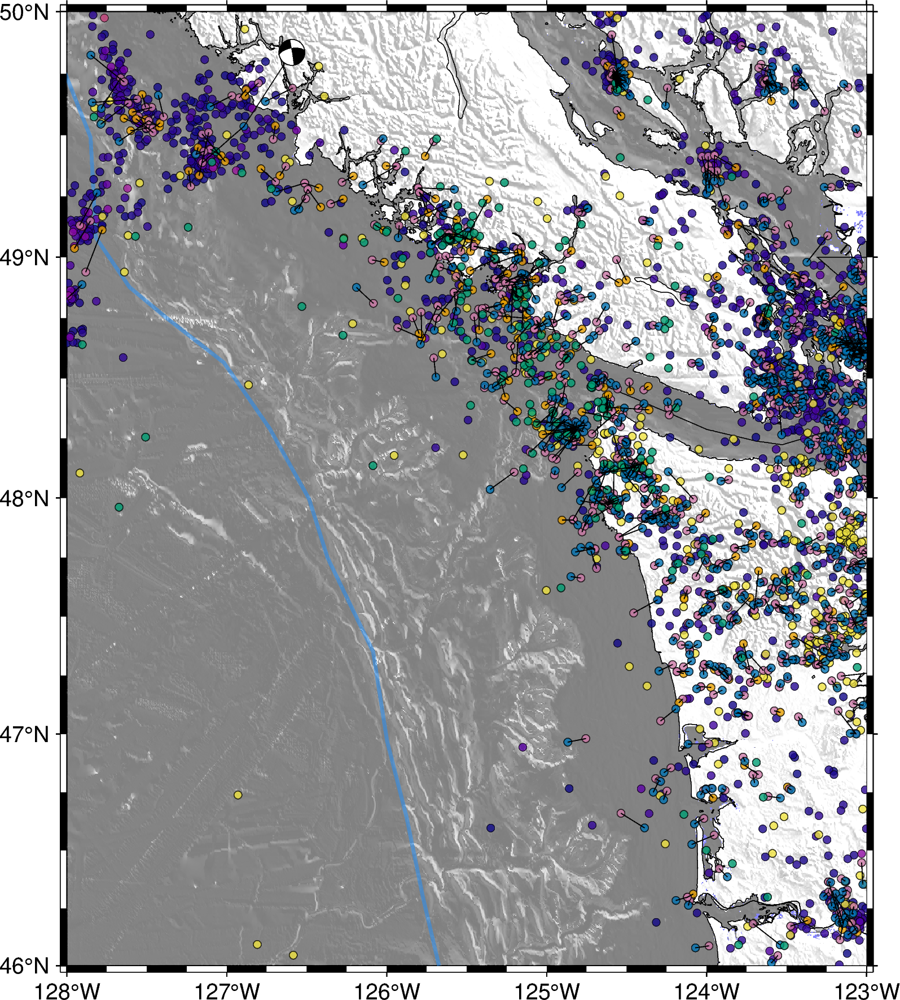

In [51]:
# Initialize the figure
fig = pygmt.Figure()

# Define target region
min_lat = 46
max_lat = 50
min_lon = -128
max_lon = -123

# Define the region to plot
region = [min_lon, max_lon, min_lat, max_lat]
title = "(d)"

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Set up the base map
fig.basemap(region=region, projection="M12c", frame="af")

fig.grdimage(grid=grid, cmap="blue", shading=shade, transparency=50)
fig.coast(region=region, projection="M12c", shorelines=True, borders=[1, 2], resolution="f")

# Add plate boundaries 
fig.plot(data="PB2002_boundaries.dig", pen="1.5p,dodgerblue1", transparency=50)

# Plot the matching events
nass_log_min = _df['nass'].min()   # Add 1 to avoid log(0) error
nass_log_max = _df['nass'].max() 
pygmt.makecpt(cmap="plasma", series=[nass_log_min, nass_log_max])


# Plot the stations with the color map applied to the logarithm of "nass"
fig.plot(x=unmatched_events_mycatalog2morton_and_anss["lon"],y=unmatched_events_mycatalog2morton_and_anss["lat"],style="c0.12c",color=unmatched_events_mycatalog2morton_and_anss["nass"] ,  cmap=True,pen="0.1p,black",transparency=20)
fig.plot(x=unmatched_events_anss2mycatalog['longitude'], y=unmatched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#F0E442', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.12c", color='#E69F00', pen="black",  transparency=20)
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.12c", color='#CC79A7', pen="black",  transparency=20)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.12c", color='#0072B2', pen="black",  transparency=20)
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.12c", color='#009E73', pen="black",  transparency=20)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="0.3p,black"
    )
    
# fig.text(x=-129.5, y=50.7, text=title, font="20p,Helvetica-Bold,black", no_clip=True)

# Plot dummy data for the legend
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#CC79A7", pen="black", transparency=20,
    label="Matched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#E69F00", pen="black", transparency=20,
    label="Matched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#0072B2", pen="black", transparency=20,
    label="Matched events of ANSS"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="white", pen="black", transparency=20,
    label="Unmatched events of our catalog"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#009E73", pen="black", transparency=20,
    label="Unmatched events of Morton-2023"
)
fig.plot(
    x=[-129.5+120], y=[50.7-30],
    style="c0.12c", color="#F0E442", pen="black", transparency=20,
    label="Unmatched events of ANSS"
)
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="1.5p,dodgerblue1",label='Plate boundaries'
    )
fig.plot(
        x=[matched_events_anss2mycatalog.iloc[0]['longitude']+120, matched_events_mycatalog2anss.iloc[0]['longitude']+120],
        y=[matched_events_anss2mycatalog.iloc[0]['latitude']-30, matched_events_mycatalog2anss.iloc[0]['latitude']-30],
        pen="0.3p,black",label='Matching lines'
    )

focal_mechanism = dict(
    strike=df.strike,
    dip=df.dip,
    rake=df.rake,
    magnitude=df.mag  # Depth in km
)

offset_beachball = 0.3
# pass the focal mechanism data to meca in addition to the scale and event location
fig.meca(focal_mechanism, scale="0.3c", longitude=df.lon, latitude=df.lat, depth=df.depth,plot_latitude=df.lat+offset_beachball,plot_longitude=df.lon+offset_beachball)

# # Add title text
# fig.colorbar(
#     position="jBC+o0.0c/0.25c+h+w8c/0.3c+ml",
#     box="+gwhite@30+p0.8p,black",
#     frame=["x+lNumber of P and S Picks"],
# )

# Add a legend for the pick scale to the plot
# fig.legend(position="JTR+w6.5+jTR", box='+gwhite+p1p')

# Save the figure
fig.savefig("../data/datasets_all_regions/northern_wa_events_2010_2015_ver3_nass_no_label_match_nass_fo.png")

# Display the figure
fig.show()

## Plot the colorbar

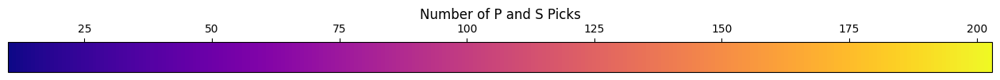

In [69]:
# Define the normalization range and colormap
min_nass = _df['nass'].min()  # Replace with the appropriate data source if needed
max_nass = _df['nass'].max()

norm = mcolors.Normalize(vmin=min_nass, vmax=max_nass)
cmap = cm.plasma  # Use the same colormap as in the previous plots

# Create a figure for the color bar
fig, ax = plt.subplots(figsize=(16, 1))  # Adjust the size as needed
fig.subplots_adjust(bottom=0.5)

# Create the color bar
cbar = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), cax=ax, orientation='horizontal')

# Set the color bar label
cbar.set_label('Number of P and S Picks', fontsize=12)

# Move the ticks and labels above the color bar
cbar.ax.xaxis.set_ticks_position('top')  # Move ticks to the top
cbar.ax.xaxis.set_label_position('top')  # Move the label to the top

# Save the color bar as a PNG
fig.savefig("colorbar.png", dpi=300, bbox_inches='tight')

# Display the color bar
plt.show()